### Projekt końcowy - Analiza Danych Przestrzennych 

 Członkowie zespołu

- Kamil Kaniera - 247689
- Krzysztof Purgat - 247771
- Julia Nocuń - 247744

# Wstęp do projektu

Celem projektu jest stworzenie systemu wizualizacji danych dotyczących pandemii COVID-19, z wykorzystaniem map statycznych i interaktywnych. Projekt analizuje dane przestrzenne i czasowe, koncentrując się na potwierdzonych przypadkach, zgonach i wyzdrowieniach w różnych regionach geograficznych. Dane pochodzą z początkowej fazy pandemii, tj. z okresu pomiędzy 22.01.2020 a 11.03.2020.
Wizualizacje umożliwią ocenę dynamiki rozprzestrzeniania się wirusa oraz wskażą stopień, w jakim poszczególne regiony zostały dotknięte pandemią.

## Zakres projektu

1. **Analiza danych przestrzennych**: Potwierdzone przypadki, zgony i wyzdrowienia są analizowane pod kątem lokalizacji i zmieniających się wartości w czasie.

2. **Mapy statyczne**: Wizualizacja danych w trzech kategoriach: przypadki potwierdzone, zgony i wyzdrowienia z podziałem na kontynenty.

3. **Mapy interaktywne**: Dynamiczne mapy z time sliderem, umożliwiające użytkownikowi obserwację zmian w czasie oraz mapa zwierająca zgrupowane znaczniki z poszczególnych miejsc dotknietych pandemią jak również heatmapy obrazujące natężenie potwierdzonych przypadków, zgonów i wyzdrowień na odpowiednich warstwach. Dodatkowo, w projekcie zawarte są wykresy ilustrujące dynamikę pandemii w czasie.

Projekt ma na celu dostarczenie narzędzia do analizy i wizualizacji rozprzestrzeniania się pandemii w czasie i przestrzeni.


In [3]:
import pandas as pd
import matplotlib.pyplot as plt
import folium
from folium.plugins import TimestampedGeoJson, MarkerCluster, HeatMap
import plotly.express as px
import geopandas as gpd
import matplotlib.patches as mpatches
import os
import matplotlib.pyplot as plt

### Na początku analizy wczytaliśmy dane, zawierające granice kontynentów, państw i regionów, które pozwolą nam na stworzenie map statycznych

#### Poszczególne kroki:
1. **Import danych**: Wczytanie pliku `custom.geo.json` jako obiektu `GeoDataFrame` za pomocą `geopandas`.
2. **Zmiana układu współrzędnych**: Transformacja danych do układu EPSG:3857 (Web Mercator).
3. **Podgląd danych**: Wyświetlenie pierwszych kilku wierszy danych za pomocą `head()`.

In [5]:
countries = gpd.GeoDataFrame(gpd.read_file('custom.geo.json'))
countries.to_crs(epsg=3857, inplace=True)
countries.head()

,featurecla,scalerank,labelrank,sovereignt,sov_a3,adm0_dif,level,type,tlc,admin,...,fclass_id,fclass_pl,fclass_gr,fclass_it,fclass_nl,fclass_se,fclass_bd,fclass_ua,filename,geometry
0,Admin-0 country,1,5,Costa Rica,CRI,0,2,Sovereign country,1,Costa Rica,...,None,None,None,None,None,None,None,None,CRI.geojson,"POLYGON ((-9190935.04 1071067.715, -9191565.56..."
1,Admin-0 country,1,5,Nicaragua,NIC,0,2,Sovereign country,1,Nicaragua,...,None,None,None,None,None,None,None,None,NIC.geojson,"POLYGON ((-9257052.73 1688401.081, -9260150.97..."
2,Admin-0 country,3,6,France,FR1,1,2,Dependency,1,Saint Martin,...,None,None,None,None,None,None,None,None,MAF.geojson,"POLYGON ((-7014372.655 2045620.052, -7026825.4..."
3,Admin-0 country,3,6,Netherlands,NL1,1,2,Country,1,Sint Maarten,...,None,None,None,None,None,None,None,None,SXM.geojson,"POLYGON ((-7026825.435 2045620.052, -7014372.6..."
4,Admin-0 country,1,5,Haiti,HTI,0,2,Sovereign country,1,Haiti,...,None,None,None,None,None,None,None,None,HTI.geojson,"MULTIPOLYGON (((-7990429.342 2239673.309, -798..."


### Następnie wczytane zostały dane dotyczące potwierdzonych przypadków, zgonów i wyzdrowień w trakcie początkowej fazy pandemii COVID-19.

#### Poszczególne kroki:
1. **Wczytanie danych**: Import pliku CSV `COVID-19_geo_timeseries_last4.csv` za pomocą `pandas`.
2. **Konwersja czasu**: Konwersja kolumny `update_time` na typ datetime, uwzględniając różne formaty i pomijając błędy.
3. **Agregacja danych**: Grupowanie danych według kraju, prowincji, szerokości i długości geograficznej oraz sumowanie wartości potwierdzonych przypadków, zgonów i ozdrowień.
4. **Podgląd danych**: Wyświetlenie pierwszych kilku wierszy danych za pomocą `head()`.


In [7]:
data = pd.read_csv('COVID-19_geo_timeseries_last4.csv')

data['update_time'] = pd.to_datetime(data['update_time'], format='mixed',
                                     errors='coerce')

country_data = data.groupby(
    ['country', 'province', 'latitude', 'longitude']).agg({
    'confirmed_cases': 'sum',
    'deaths': 'sum',
    'recovered': 'sum'
}).reset_index()

country_data.head()

,country,province,latitude,longitude,confirmed_cases,deaths,recovered
0,Afghanistan,Afghanistan,33.939110,67.709953,33,0,0
1,Albania,Albania,41.153332,20.168331,24,1,0
2,Algeria,Algeria,28.033886,1.659626,151,0,0
3,Andorra,Andorra,42.546245,1.601554,10,0,0
4,Argentina,Argentina,-38.416097,-63.616672,73,4,0


## Mapy statyczne 

### Na podstawie wczytanych danych stworzyliśmy mapy statyczne przedstawiające liczbę potwierdzonych przypadków, zgonów i wyzdrowień na poszczególnych kontynentach.

#### Poszczególne kroki:
1. **Grupowanie danych**: Grupowanie danych COVID-19 według krajów i sumowanie przypadków, zgonów oraz wyzdrowień.
2. **Łączenie danych**: Połączenie danych COVID-19 z danymi geograficznymi na podstawie nazw krajów.
3. **Obliczanie granic mapy**: Definicja funkcji do obliczania dynamicznych granic mapy na podstawie geometrii i kontynentu.
4. **Tworzenie map**: Generowanie map dla każdego kontynentu, wizualizujących liczbę potwierdzonych przypadków, zgonów i wyzdrowień.


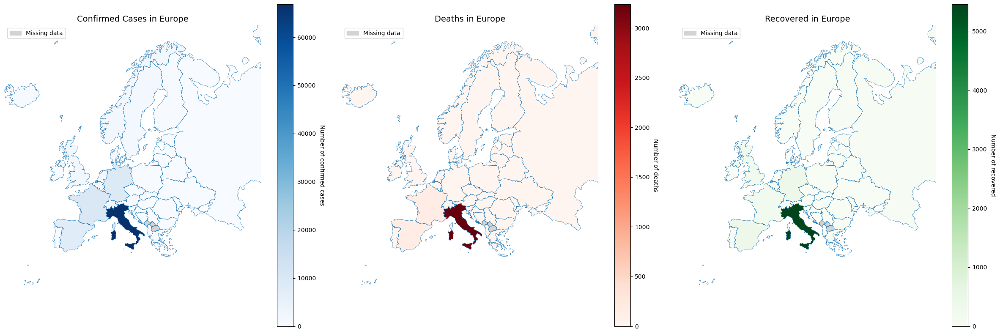

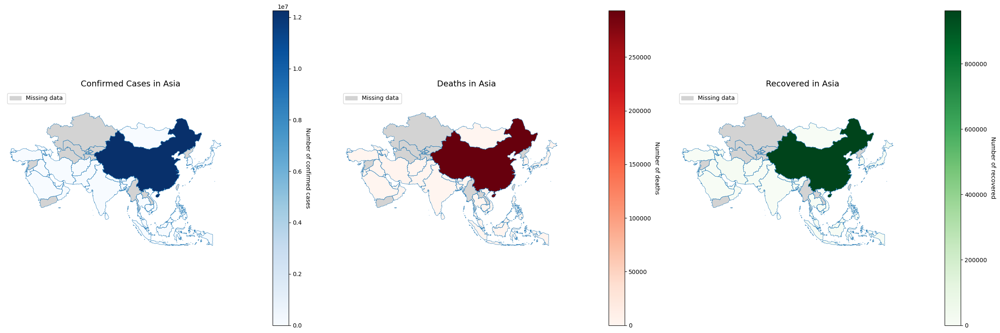

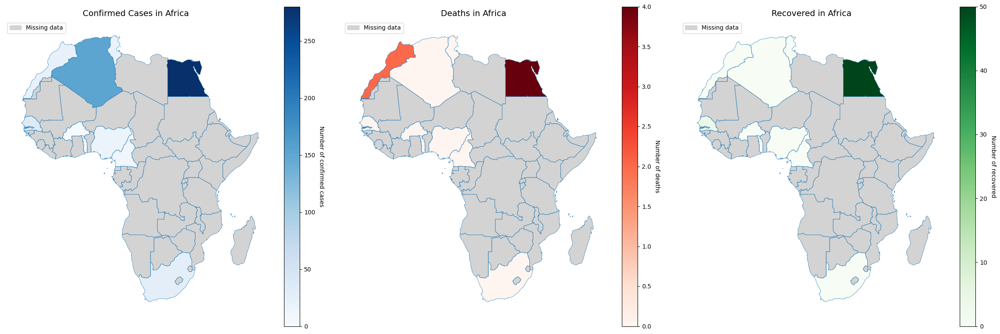

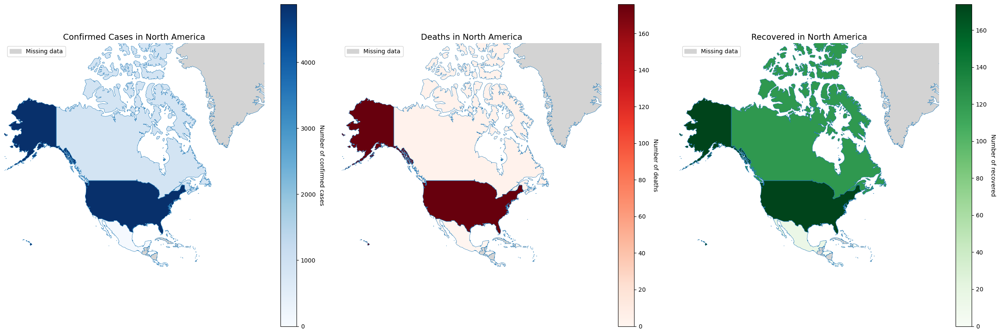

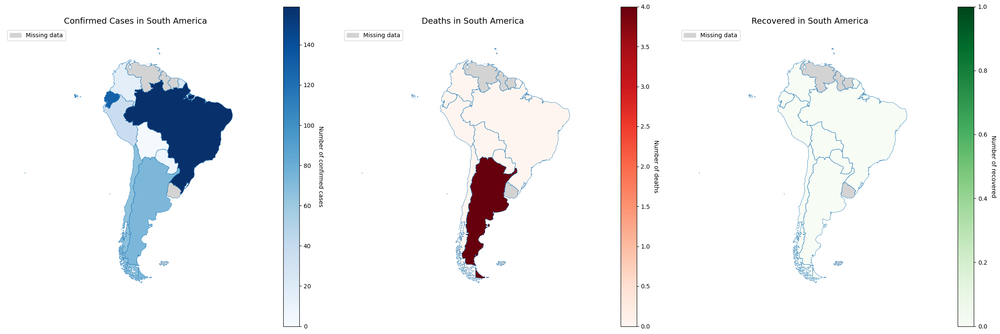

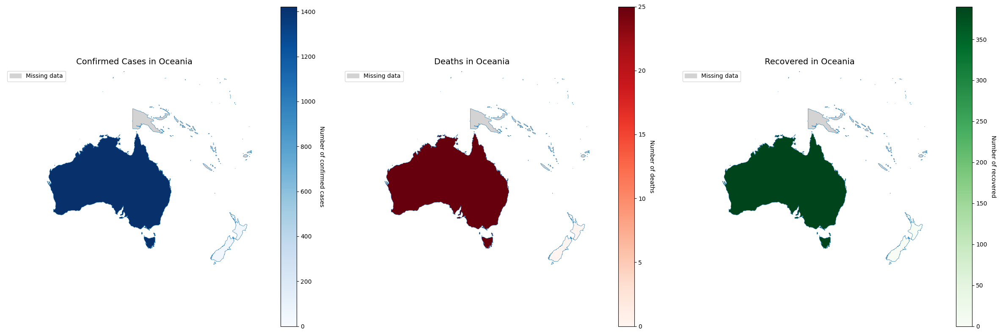

In [10]:
# Grupuj dane COVID-19 według krajów
covid_grouped = data.groupby("country").agg({
    "confirmed_cases": "sum",
    "deaths": "sum",
    "recovered": "sum"
}).reset_index()

# Połącz dane na podstawie kolumny name_en (geojson) i country (CSV)
merged = countries.merge(covid_grouped, left_on="name_en", right_on="country",
                         how="left")


def get_custom_bounds_for_continent(continent):
    custom_bounds = {
        "Europe": [-2700000, 6000000, 2500000, 12000000],
        "Asia": [2500000, 18500000, -1000000, 8875000],
        "Africa": [-2500000, 6000000, -4500000, 5000000],
        "North America": [-19000000, -2500000, -500000, 15000000],
        "South America": [-13000000, -2500000, -8450000, 2700000],
        "Oceania": [11000000, 20500000, -6000000, 1200000]
    }
    return custom_bounds.get(continent)


def plot_maps_for_continent(data, continent):
    fig, axes = plt.subplots(1, 3, figsize=(24, 8))

    metrics = [
        ("confirmed_cases", "Confirmed Cases", "Blues"),
        ("deaths", "Deaths", "Reds"),
        ("recovered", "Recovered", "Greens")
    ]

    bounds = get_custom_bounds_for_continent(continent)

    if continent == "South America":
        # Dodaj geometrię Francji oraz dane Gujany Francuskiej
        france_geometry = countries[countries["name_en"] == "France"]
        guiana_data = covid_grouped[covid_grouped["country"] == "French Guiana"]

        # Połącz dane Gujany Francuskiej z geometrią Francji
        france_geometry = france_geometry.copy()
        france_geometry["name_en"] = "French Guiana"
        france_geometry["continent"] = "South America"
        france_geometry = france_geometry.merge(guiana_data, left_on="name_en", right_on="country", how="left")

        # Dodaj do zbioru danych
        data = pd.concat([data, france_geometry])

    data = data[data["continent"] == continent]

    for ax, (column, title, cmap) in zip(axes, metrics):
        data.boundary.plot(ax=ax, linewidth=0.5)
        data.plot(
            column=column,
            cmap=cmap,
            legend=False,
            ax=ax,
            missing_kwds={"color": "lightgrey", "label": "No data"},
            vmin=0
        )

        sm = plt.cm.ScalarMappable(cmap=cmap, norm=plt.Normalize(vmin=0,
                                                                 vmax=max(1,
                                                                          data[
                                                                              column].max())))
        cbar = fig.colorbar(sm, ax=ax)
        cbar.set_label(f"Number of {title.lower()}", rotation=270, labelpad=15)

        missing_data_patch = mpatches.Patch(color="lightgrey",
                                            label="Missing data")
        ax.legend(handles=[missing_data_patch], loc="upper left", fontsize=10)

        ax.set_title(f"{title} in {continent}", fontsize=14)
        ax.axis("off")
        ax.set_xlim(bounds[:2])
        ax.set_ylim(bounds[2:])

    plt.tight_layout()
    plt.show()
    plt.close()


continents = ["Europe", "Asia", "Africa", "North America", "South America",
              "Oceania"]

for continent in continents:
    plot_maps_for_continent(merged, continent)

## Mapa interaktywna: Liczba przypadków COVID-19

#### Kolejnym krokiem naszej analizy było stworzenie mapy interaktywnej przedstawiającej 4 warstwy:
#### - Warstwa zawierająca zgrupowane znaczniki z informacjami o lokalizacji, przypadkach, zgonach i wyzdrowieniach.
#### -Trzy warstwy, gdzie każda z nich zawiera heatmapę kolejno dla potwierdzonych przypadków, zgonów i wyzdrowień.

#### Poszczególne kroki:
1. **Tworzenie mapy początkowej**: Inicjalizacja mapy z centralnym widokiem opartym na średnich współrzędnych danych.
2. **MarkerCluster**: Dodanie zgrupowanych znaczników dla miejsc z informacjami o przypadkach, zgonach i wyzdrowieniach.
3. **Heatmapy**: Generowanie warstw heatmap dla potwierdzonych przypadków, zgonów i wyzdrowień.
4. **Integracja warstw**: Dodanie grup znaczników i heatmap do mapy.

In [13]:
# Tworzenie mapy początkowej
mapa = folium.Map(location=[country_data['latitude'].mean(),
                            country_data['longitude'].mean()], zoom_start=2)

# Tworzenie grupy MarkerCluster dla zgrupowanych znaczników
marker_cluster = MarkerCluster(name="COVID cases around the world",
                               show=False).add_to(mapa)

# Lista do przechowywania punktów dla heatmap
heatmap_confirmed = []
heatmap_deaths = []
heatmap_recovered = []

# Iteracja po danych i dodanie znaczników
for _, row in country_data.iterrows():
    # Sprawdzanie, czy kolumna 'province' jest pusta
    location_name = row['province'] if pd.notna(row['province']) and row[
        'province'].strip() != '' else row['country']

    popup_text = (
        f"<b>Miejsce:</b> {location_name}, {row['country']}<br>"
        f"<b>Potwierdzone przypadki:</b> {row['confirmed_cases']}<br>"
        f"<b>Zgony:</b> {row['deaths']}<br>"
        f"<b>Wyzdrowienia:</b> {row['recovered']}"
    )

    # Dodanie znacznika do grupy MarkerCluster
    folium.Marker(
        location=[row['latitude'], row['longitude']],
        popup=folium.Popup(popup_text, max_width=300),
        icon=folium.Icon(color="darkblue", icon="info-sign")
    ).add_to(marker_cluster)

    # Dodanie danych do heatmapy
    heatmap_confirmed.append(
        [row['latitude'], row['longitude'], row['confirmed_cases']])
    heatmap_deaths.append([row['latitude'], row['longitude'], row['deaths']])
    heatmap_recovered.append(
        [row['latitude'], row['longitude'], row['recovered']])

# Tworzenie heatmapy dla potwierdzonych przypadków
confirmed_heatmap = folium.FeatureGroup(name="Confirmed cases - heatmap",
                                        show=False)
HeatMap(heatmap_confirmed, radius=15, max_zoom=13).add_to(confirmed_heatmap)

# Tworzenie heatmapy dla zgonów
deaths_heatmap = folium.FeatureGroup(name="Deaths - heatmap", show=False)
HeatMap(heatmap_deaths, radius=15, max_zoom=13).add_to(deaths_heatmap)

# Tworzenie heatmapy dla wyzdrowień
recovered_heatmap = folium.FeatureGroup(name="Recovered - heatmap", show=False)
HeatMap(heatmap_recovered, radius=15, max_zoom=13).add_to(recovered_heatmap)

confirmed_heatmap.add_to(mapa)
deaths_heatmap.add_to(mapa)
recovered_heatmap.add_to(mapa)
marker_cluster.add_to(mapa);


In [14]:
folium.LayerControl().add_to(mapa)

mapa.save("mapa_covid.html")
mapa

## Liczba przypadków COVID-19 w czasie

### W celu analizy jak w początkowej fazie pandemii zmieniała się liczba potwierdzonych przypadków, zgonów i ozdrowień oraz wyciągnięcia wnisków wynikających z trendu, stworzono trzy wykresy dotyczące zmienności ilości przypadków w czasie.

#### Poszczególne kroki:
1. **Grupowanie danych według czasu**  
   Dane są grupowane według kolumny `update_time`, a następnie sumowane dla trzech kluczowych kategorii:
   - `confirmed_cases` (potwierdzone przypadki),
   - `deaths` (zgony),
   - `recovered` (wyzdrowienia).  
   Wynik jest zapisany w nowej zmiennej `time_data`.
2. **Wizualizacja danych**
   Trzy oddzielne wykresy prezentują trendy w czasie dla różnych kategorii danych.
    - Wykres 1: Potwierdzone przypadki:
        Wizualizacja liczby potwierdzonych przypadków w czasie. Na osi X znajduje się update_time (data), a na osi Y liczba przypadków. Wykres jest oznaczony kolorem niebieskim.
    - Wykres 2: Zgony:
        Wizualizacja liczby zgonów związanych z COVID-19. Dane są przedstawione w czasie za pomocą czerwonej linii.
    - Wykres 3: Wyzdrowienia:
        Prezentacja liczby wyzdrowień w czasie. Wykres ma zieloną linię, która wskazuje trend ilości osób, które wyzdrowiały.


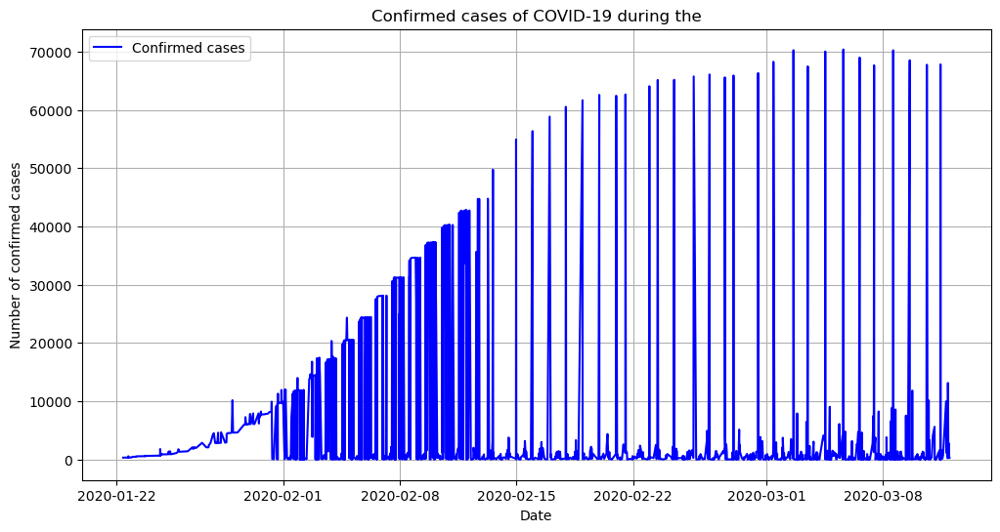

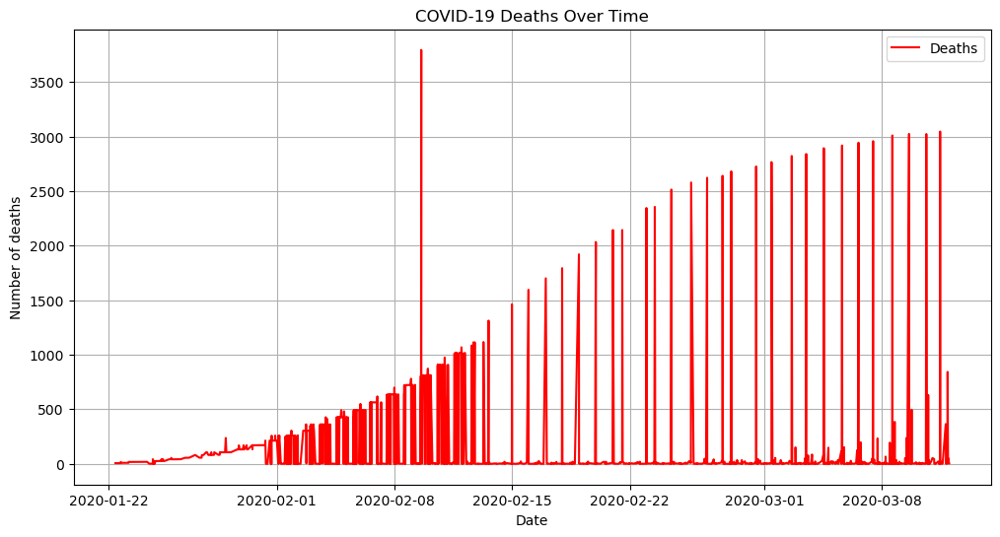

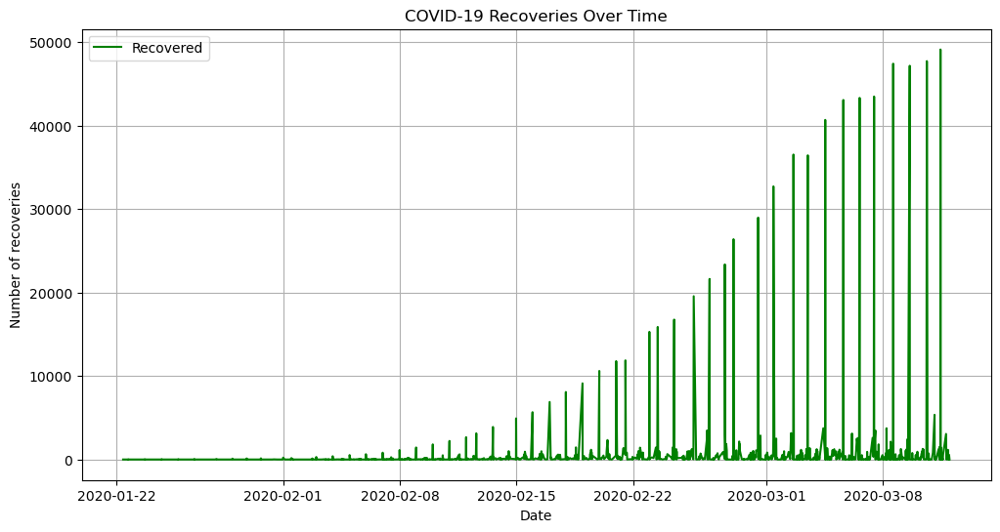

In [17]:
# Grupowanie danych według czasu
time_data = data.groupby(['update_time']).agg({
    'confirmed_cases': 'sum',
    'deaths': 'sum',
    'recovered': 'sum'
}).reset_index()

# Wykres 1: Potwierdzone przypadki
plt.figure(figsize=(12, 6))
plt.plot(time_data['update_time'], time_data['confirmed_cases'],
         label='Confirmed cases', color='blue')
plt.title('Confirmed cases of COVID-19 during the')
plt.xlabel('Date')
plt.ylabel('Number of confirmed cases')
plt.grid()
plt.legend()
plt.show()

# Wykres 2: Zgony
plt.figure(figsize=(12, 6))
plt.plot(time_data['update_time'], time_data['deaths'], label='Deaths',
         color='red')
plt.title('COVID-19 Deaths Over Time')
plt.xlabel('Date')
plt.ylabel('Number of deaths')
plt.grid()
plt.legend()
plt.show()

# Wykres 3: Wyzdrowienia
plt.figure(figsize=(12, 6))
plt.plot(time_data['update_time'], time_data['recovered'], label='Recovered',
         color='green')
plt.title('COVID-19 Recoveries Over Time')
plt.xlabel('Date')
plt.ylabel('Number of recoveries')
plt.grid()
plt.legend()
plt.show()


## Mapy z time sliderem: Rozmieszczenie potwierdzonych przypadków, zgonów oraz wyzdrowień

#### W celu lepszego zobrazowania, jak zmieniała się w czasie początkowej fazy pandemii ilość potwierdzonych przypadków, zgonów i ozdrowień przygotowaliśmy mapy z time sliderem. 

### Poszczególne kroki:
1. **Usunięcie wierszy z brakującymi współrzędnymi**: Odfiltrowanie danych, które nie zawierają wartości `latitude`, `longitude` oraz `update_time`.
2. **Konwersja czasu**: Przekształcenie kolumny `update_time` na format datetime.
3. **Generowanie GeoJSON**: Tworzenie dynamicznych obiektów GeoJSON dla różnych kategorii (potwierdzone przypadki, zgony, wyzdrowienia) z informacjami w popupach.
4. **Tworzenie animowanych map**: Wykorzystanie `TimestampedGeoJson` do przedstawienia zmian w czasie dla każdego zjawiska.

In [20]:
# Usunięcie wierszy z brakującymi współrzędnymi
timeline_data = data.dropna(subset=['latitude', 'longitude', 'update_time'])

# Konwersja kolumny update_time na format datetime
timeline_data.loc[:, 'update_time'] = pd.to_datetime(
    timeline_data['update_time'])


# Funkcja do generowania GeoJSON z dynamicznym popupem
def generate_geojson(data, category, color):
    features = []
    for _, row in data.iterrows():
        location_name = row['province'] if pd.notna(row['province']) and row[
            'province'].strip() != '' else row['country']

        # Zmienna dla wartości do wyświetlenia w popupie
        value = row[category]
        category_name = {
            'confirmed_cases': "Confirmed cases",
            'deaths': "Deaths",
            'recovered': "Recovered"
        }.get(category, "Unknown category")

        feature = {
            "type": "Feature",
            "geometry": {"type": "Point",
                         "coordinates": [row["longitude"], row["latitude"]]},
            "properties": {
                "time": row["update_time"].isoformat(),
                "popup": f"<b>Miejsce:</b> {location_name}<br>"
                         f"<b>{category_name}:</b> {value}",
                "icon": "circle",
                "iconstyle": {
                    "color": color,
                    "fillColor": color,
                    "fillOpacity": 0.6,
                    "stroke": "true",
                    "radius": 10,
                },
            }
        }
        features.append(feature)
    return {"type": "FeatureCollection", "features": features}


# Tworzenie trzech oddzielnych map
def create_map(data, category, color):
    map = folium.Map(
        location=[data['latitude'].mean(), data['longitude'].mean()],
        zoom_start=1.5)
    geojson_data = generate_geojson(data, category, color)
    layer = TimestampedGeoJson(
        geojson_data,
        transition_time=5000,
        loop=True,
        auto_play=False,
        add_last_point=True,
        duration="P1D"
    )
    layer.add_to(map)
    return map


# Filtrowanie danych na podstawie confirmed_cases w timeline_data
confirmed_cases_map = create_map(timeline_data[timeline_data['confirmed_cases'] > 0], 'confirmed_cases', "blue")
deaths_map = create_map(timeline_data[timeline_data['deaths'] > 0], 'deaths', "red")
recovered_map = create_map(timeline_data[timeline_data['recovered'] > 0], 'recovered', "green")


Mapa potwierdzonych przypadków

In [22]:
confirmed_cases_map

Mapa zgonów

In [24]:
deaths_map

Mapa wyzdrowień

In [26]:
recovered_map

## Wykresy interaktywne

#### Stworzyliśmy również interaktywne wykresy dynamiki COVID-19, które pozwalają na analizę zmian liczby przypadków, zgonów i wyzdrowień w czasie, co ułatwia identyfikację trendów i kluczowych momentów pandemii. Dzięki nim można lepiej zrozumieć rozwój epidemi każdego dnia jej początkowej fazy. 

### Poszczególne kroki:
1. **Grupowanie danych według czasu**: Sumowanie przypadków, zgonów i wyzdrowień w poszczególnych dniach.
2. **Wizualizacja trendów**: Tworzenie wykresów liniowych pokazujących dynamikę zmian w czasie.
3. **Prezentacja wyników**: Oś czasu jako zmienna niezależna, a liczba przypadków, zgonów i wyzdrowień jako wartości mierzone.

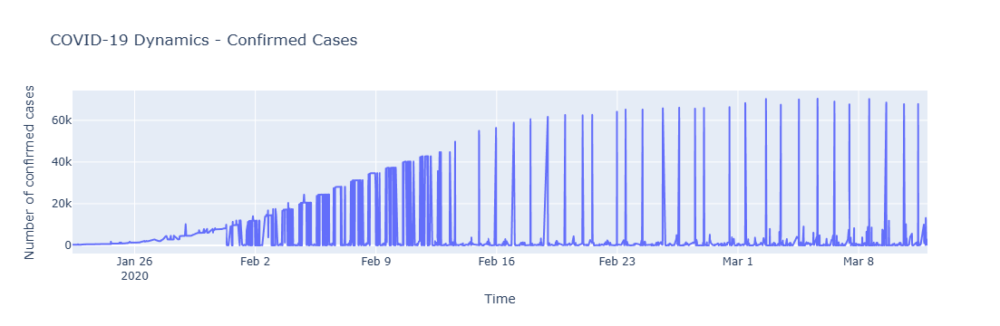

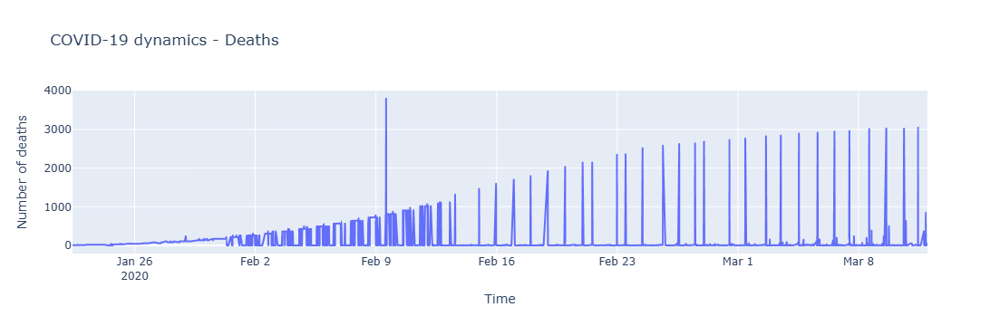

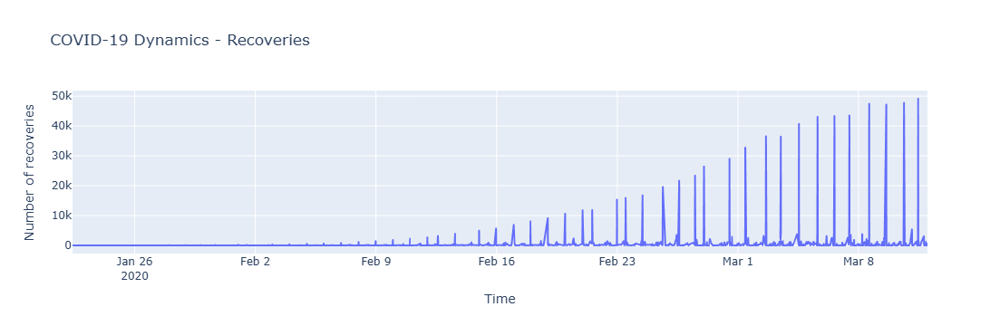

In [29]:
# Wykres dla potwierdzonych przypadków
fig_cases = px.line(
    time_data,
    x='update_time',
    y='confirmed_cases',
    labels={'confirmed_cases': 'Number of confirmed cases',
            'update_time': 'Time'},
    title='COVID-19 Dynamics - Confirmed Cases'
)
fig_cases.show()

# Wykres dla zgonów
fig_deaths = px.line(
    time_data,
    x='update_time',
    y='deaths',
    labels={'deaths': 'Number of deaths', 'update_time': 'Time'},
    title='COVID-19 dynamics - Deaths'
)
fig_deaths.show()

# Wykres dla wyzdrowień
fig_recovered = px.line(
    time_data,
    x='update_time',
    y='recovered',
    labels={'recovered': 'Number of recoveries', 'update_time': 'Time'},
    title='COVID-19 Dynamics - Recoveries'
)
fig_recovered.show()

## Wnioski wynikające z przeprowadzonych analiz

#### Na podstawie powyższych analiz możemy zauważyć, że:

1. **Europa:** W początkowej fazie pandemii najwięcej przypadków i zgonów odnotowano we Włoszech, co może wskazywać na szybkie rozprzestrzenianie się wirusa w regionie oraz ograniczoną początkowo skuteczność środków zapobiegawczych.

2. **Azja:** Chiny miały zdecydowanie największą liczbę przypadków, zgonów i wyzdrowień, co sugeruje, że były epicentrum pandemii, ale także podjęły szybkie i skuteczne działania w zakresie leczenia i izolacji chorych.

3. **Afryka:** Liczba przypadków, zgonów i wyzdrowień była znacznie niższa niż w Europie i Azji, co może wynikać z mniejszej liczby testów, różnic w systemach raportowania lub opóźnionego pojawienia się wirusa na tym kontynencie.

4. **Ameryka Południowa:** Analiza danych wskazuje na duże zróżnicowanie sytuacji epidemiologicznej między krajami. Najwięcej przypadków odnotowano w Brazylii, co może wynikać z liczby testów i wielkości populacji. Argentyna natomiast ma najwyższą liczbę zgonów. Różnice w danych mogą być efektem systemów opieki zdrowotnej, demografii oraz czynników społeczno-ekonomicznych.

5. **Ameryka Północna:** Analiza danych pokazuje, że Stany Zjednoczone mają najwyższą liczbę przypadków, zgonów i wyzdrowień, co może wynikać z dużej populacji, liczby testów i dostępu do opieki zdrowotnej. Kanada i Meksyk notują niższe wartości, co może być związane z różnicami w testowaniu i systemie opieki zdrowotnej. Różnice między krajami wynikają z czynników demograficznych, zdrowotnych i społecznych.

6. **Australia i Oceania**: Analiza danych pokazuje, że pomimo stosunkowo dużej liczby odnotowanych przpadków zachorowań na COVID-19 w Australii liczba zgonów w okresie raportowania danych była niewielka, a ilość wyzdrowień wyniosła prawie 25%, co może świadczyć o dobrej opiece zdrowotnej, profilaktyce oraz o szybkim rozpoczęciu działań mających na celu ograniczenie rozprzestrzeniania się i skutków pandemii.


#### Na podstawie wykresu przedstawiającego liczbę potwierdzonych przypadków COVID-19 w czasie, można wyciągnąć kilka wniosków:

1. **Szybki wzrost przypadków**: Od końca stycznia 2020 roku liczba potwierdzonych przypadków zaczęła gwałtownie rosnąć, co wskazuje na szybkie rozprzestrzenianie się wirusa w początkowej fazie pandemii
2. **Szczyt w połowie lutego**: Wykres pokazuje, że liczba przypadków osiągnęła szczyt w połowie lutego 2020 roku, co może sugerować, że w tym okresie wirus był najbardziej aktywny.
3. **Zmienność w czasie i ogólny trend wzrostowy**: Po osiągnięciu szczytu, liczba przypadków zaczęła się wahać, ale ogólny trend pozostał wzrostowy aż do początku marca 2020 roku. To może wskazywać na różne czynniki wpływające na liczbę przypadków, takie jak wprowadzenie środków zapobiegawczych, zmiany w testowaniu czy raportowaniu.
#### Na podstawie wykresu przedstawiającego liczbę zgonów związanych z COVID-19 w czasie, można wyciągnąć kilka wniosków:

1. **Wzrost liczby zgonów**: Od końca stycznia 2020 roku liczba zgonów zaczęła gwałtownie rosnąć, co wskazuje na szybkie rozprzestrzenianie się wirusa i jego poważne skutki zdrowotne.
2. **Szczyt w lutym**: Wykres pokazuje, że liczba zgonów osiągnęła szczyt na początku lutego 2020 roku, co może sugerować, że w tym okresie wirus był najbardziej śmiertelny.
3. **Stały wzrost**: Po osiągnięciu szczytu, liczba zgonów nadal rosła, choć w nieco wolniejszym tempie, aż do początku marca 2020 roku. To może wskazywać na różne czynniki wpływające na liczbę zgonów, takie jak wprowadzenie środków zapobiegawczych, zmiany w testowaniu czy raportowaniu.
4. **Największa liczba zgonów**: Z wykresu możemy również odczytać, że największa liczba odnotowanych zgonów miała miejsce 09.02.2020 i wynosiła aż 873, co jest wartością znacznie odstającą od pomiarów wykonanych w pozostałych dniach.

#### Na podstawie wykresu przedstawiającego liczbę wyzdrowień z COVID-19 w czasie, można wyciągnąć kilka wniosków:

1. **Stały wzrost wyzdrowień**: Od końca stycznia 2020 roku liczba wyzdrowień zaczęła rosnąć, co wskazuje na skuteczność leczenia i izolacji chorych.
2. **Znaczące skoki**: Wykres pokazuje kilka wyraźnych skoków w liczbie wyzdrowień, co może sugerować, że w tych okresach więcej osób zostało wyleczonych lub dane zostały dokładniej zaktualizowane.
3. **Ogólny trend wzrostowy**: Pomimo zmienności liczby wyzdrowień w czasie, ogólny trend jest wzrostowy, co stanowi pozytywny sygnał w kontekście walki z pandemią.